In [1]:
from display import *
from obspy import read,UTCDateTime
import pandas as pd
import matplotlib.dates as md
from geographiclib.geodesic import Geodesic

In [42]:
dir_summary='summaries/20090902/ELD'
tag='example'
wave_path = './/data/CWBSN_SAC/2009/20090902/*.ELD*'

In [3]:
def dist_to_point(pd_ls_cata, center_lat, center_lon):
    dist = []
    for i in range(len(pd_ls_cata)):
        event_lat = pd_ls_cata.iloc[i].lat
        event_lon = pd_ls_cata.iloc[i].lon
        distance = Geodesic.WGS84.Inverse(center_lat, center_lon, event_lat, event_lon)['a12'] * 111
        dist.append(distance)
    pd_ls_cata["dist_to_sta"] = dist
    return pd_ls_cata

In [4]:
def make_cumus(event_times):
    x = event_times
    c = [1] * len(x)
    y = [sum(c[0:x:1]) for x in range(len(x)+1)]
    return x, y

/home/lchuang/projects/scatnet/display.py:95: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/lchuang/projects/scatnet/display.py:96: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



[0 1 2 3 4 5 6 7 8 9]


(<Figure size 720x288 with 1 Axes>,
 <AxesSubplot:title={'center':'Cumulative within-clusters detections'}, ylabel='Number of events'>)

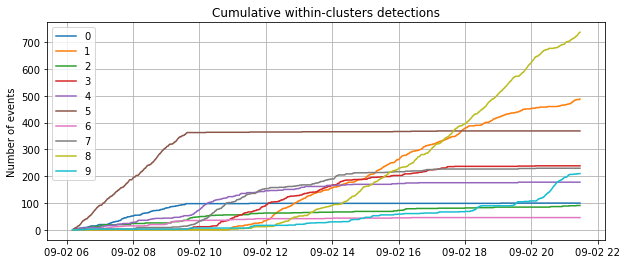

In [52]:
epoch = 100
show_detections(dir_summary, tag, epoch=epoch, dir_output=None,save='detections_{:05d}.png', norm=None)

/home/lchuang/projects/scatnet/display.py:145: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/lchuang/projects/scatnet/display.py:146: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/lchuang/projects/scatnet/display.py:147: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



(<Figure size 432x288 with 1 Axes>,
 <AxesSubplot:title={'center':'Scattering latent space'}, xlabel='First latent variable', ylabel='Second latent variable'>)

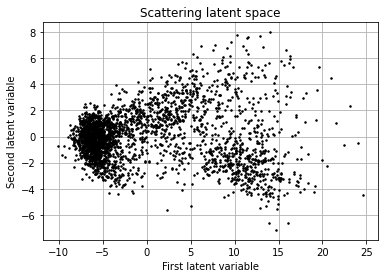

In [53]:
show_latent(dir_summary, tag, epoch=epoch, dir_output=None, save='latent.png')

/home/lchuang/projects/scatnet/display.py:257: MatplotlibDeprecationWarning:

The 'basey' parameter of __init__() has been renamed 'base' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.



(<Figure size 432x288 with 2 Axes>,
 array([ <AxesSubplot:title={'center':'Graph time scales'}, ylabel='Patch shape'>,
        <AxesSubplot:xlabel='Layer index', ylabel='Frequency (Hz)'>], dtype=object))

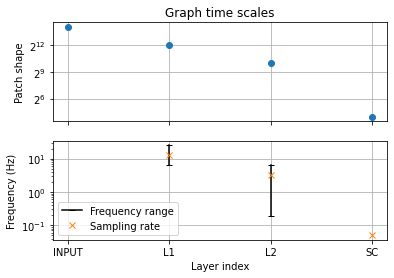

In [54]:
show_graph(dir_summary, tag, dir_output=None, save='graph.png')

In [55]:
def cluster_opt_to_pds(file_path):
    
    # ---- read in the h5py output file
    with h5py.File(file_path, 'r') as hf:
        time = hf['time'].value
        hot = hf['epoch_{:05d}'.format(epoch)]['hot'].value
    
    # ---- convert time format
    time_c = md.num2date(time)
    time_f = [UTCDateTime(t).datetime for t in time_c]
    
    # ---- conver them to a pd file
    pd_cluster = pd.DataFrame()
    pd_cluster["time"] = time_f
    pd_cluster["c_index"] = hot
    
    return pd_cluster

In [56]:
# Load cluster files
file_path = os.path.join(dir_summary, tag, 'clusters.h5')
pd_cluster = cluster_opt_to_pds(file_path)

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/ipykernel_launcher.py:5: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/ipykernel_launcher.py:6: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



In [79]:
from obspy.signal.tf_misfit import plot_tfr

def plot_spectrogram(file, b_time, etime, appd_secs):
    
    # ---- read wf
    tr=read(file,starttime=b_time-appd_secs,endtime=etime+65+appd_secs)
    tr=tr.detrend('demean')
    tr=tr.filter('highpass',freq=1)
    
    # ---- plot spectrum and spectrogram
    for i in range(len(tr)):
        plot_tfr(tr[i].data, dt=tr[i].stats.delta, fmin=2, 
        fmax=15, w0=8., nf=64, fft_zero_pad_fac=4)   

In [80]:
cluster_index=1
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster

,index,time,c_index
0,65,2009-09-02 06:33:06.560,1
1,828,2009-09-02 10:53:32.800,1
2,833,2009-09-02 10:55:15.200,1
3,836,2009-09-02 10:56:16.640,1
4,837,2009-09-02 10:56:37.120,1
5,838,2009-09-02 10:56:57.600,1
6,840,2009-09-02 10:57:38.560,1
7,844,2009-09-02 10:59:00.480,1
8,845,2009-09-02 10:59:20.960,1
9,848,2009-09-02 11:00:22.400,1


In [81]:
import plotly.graph_objs as go

# ---- plot Lin's catalog
#lin_x, lin_y = make_cumus(pd_ls_catalog.time)
#fig = go.Figure(data=[go.Scatter(x=lin_x,
#                                 y=lin_y,
#                                 marker=dict(
#                                     size=pd_ls_catalog.mag**0.5*10,
#                                     color=pd_ls_catalog.dist_to_sta,
#                                     colorbar=dict(thickness=25,x=-0.15, len=0.8)
#                                 ),
#                                 text=pd_ls_catalog.dist_to_sta,
#                                 mode='lines+markers',
#                                 name='Lins')])
fig = go.Figure()
# ---- plot clusters
for i in pd.unique(pd_cluster.c_index):
    if i != -9:
        clst_x, clst_y = make_cumus(pd_cluster[pd_cluster.c_index==i].time)
        fig.add_traces(data=[go.Scatter(x=clst_x, y=clst_y, mode='lines+markers',name=f'clst#{i}')])
    
fig.update_xaxes(rangeslider_visible=True)
fig.show()

In [82]:
def plot_align_clusters(cluster_idx, pd_cluster, wave_path, window_len, window_appd, align=False):
    # ---- extract cluster info
    pd_cluster = pd_cluster[pd_cluster.c_index==cluster_idx].reset_index()
    # ---- load waveform
    st=read(wave_path)
    st.detrend('linear')
    st.taper(max_percentage=0.005)
    st.filter('bandpass', freqmin=2,freqmax=8)
    sampling_rate = st[2].stats.sampling_rate
    st_start_time = st[2].stats.starttime
    
    # ---- numpy placeholder
    wave = []
    for i in range(len(pd_cluster)):
        offset_b_time = UTCDateTime(pd_cluster.iloc[i].time) - st_start_time - window_appd
        offset_e_time = offset_b_time + window_len + window_appd
        offset_b_sample = int(round(offset_b_time * sampling_rate))
        offset_e_sample = int(round(offset_e_time * sampling_rate))
        wv = st[2].data[offset_b_sample:offset_e_sample]
        wave.append(wv/max(abs(wv)))
        
    # ---- align waveform by ccc
    
    return np.asarray(wave), pd_cluster

In [83]:
from scipy import signal
import matplotlib.pyplot as plt

In [145]:
wv, pd_cst = plot_align_clusters(6, pd_cluster, wave_path, 65, 6)

In [146]:
#corr = signal.correlate(wv[48], wv[49], mode='same')
#fig, (ax_orig, ax_noise, ax_corr) = plt.subplots(3, 1, sharex=True)
#ax_orig.plot(wv[48])
#ax_noise.plot(wv[49], 'r')
#ax_corr.plot(corr)
#ax_corr.axhline(0.5, ls=':')
#ax_corr.set_title('Cross-correlated with rectangular pulse')
#ax_orig.margins(0, 0.1)
#fig.tight_layout()
#plt.show()

In [147]:
wv.shape[0]

46

In [148]:
fig = go.Figure()
for i in range(wv.shape[0]):
    fig.add_traces(data=go.Scatter(y=wv[i]+i))
fig.update_layout(
    width=800,
    height=600
)
fig.show()

In [149]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Heatmap(
                    z=wv,colorscale='gray'))
fig.update_layout(
    width=800,
    height=500
)
fig.show()

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



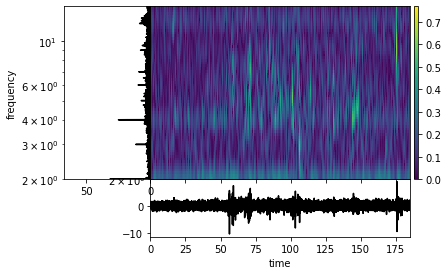

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



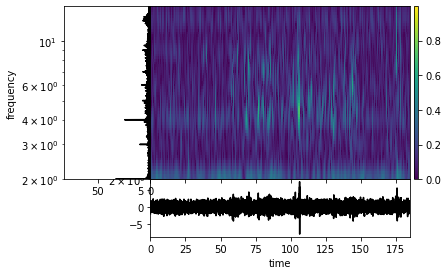

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



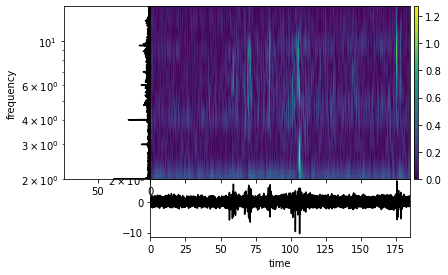

In [87]:
b_time = UTCDateTime(2009,9,2,15,50)
e_time = UTCDateTime(2009,9,2,15,51)
appd_secs=30
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



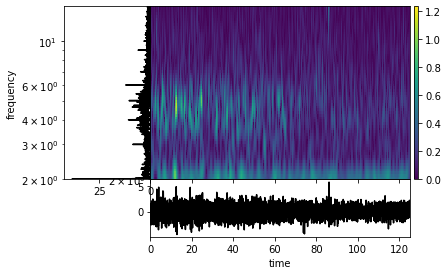

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



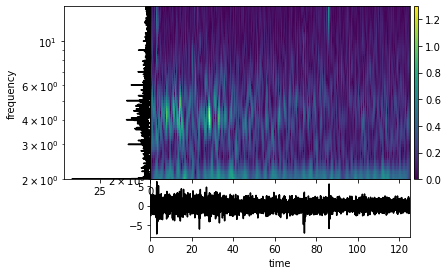

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



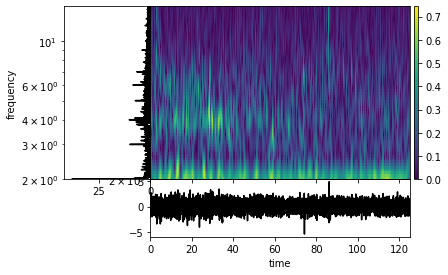

In [123]:
cluster_index=9
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[11].time)
e_time = UTCDateTime(spec_cluster.iloc[11].time)
appd_secs=30
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



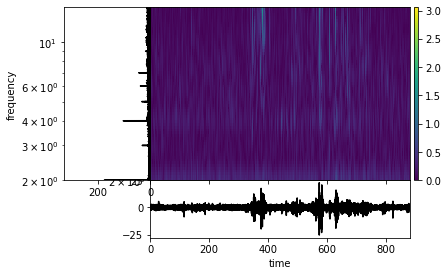

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



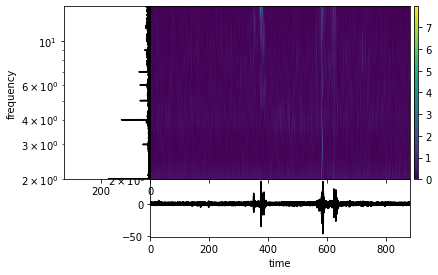

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



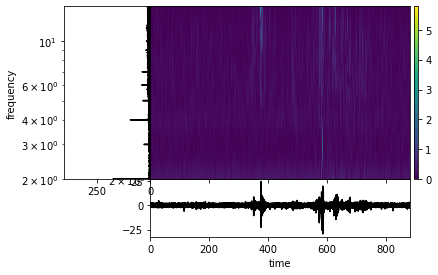

In [89]:
cluster_index=1
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[4].time)
e_time = UTCDateTime(spec_cluster.iloc[12].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



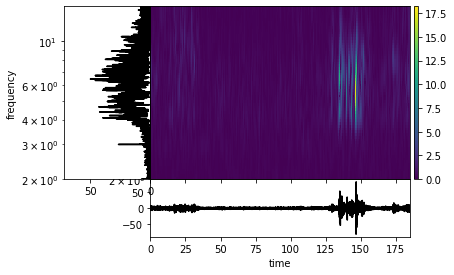

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



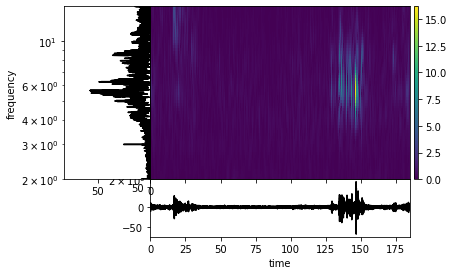

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



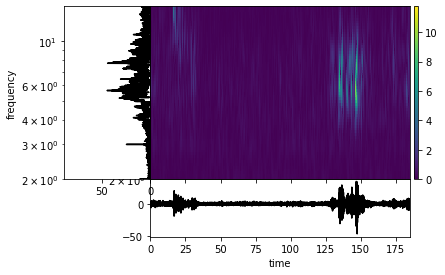

In [119]:
cluster_index=9
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[0].time)
e_time = UTCDateTime(spec_cluster.iloc[0].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

### classified as landslide (cluster 2) but not in Lin's catalog

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



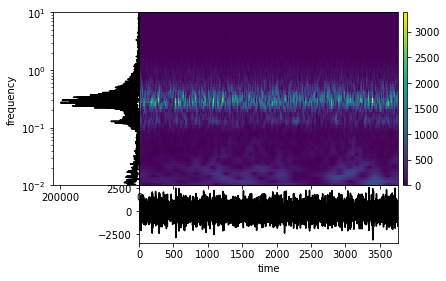

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



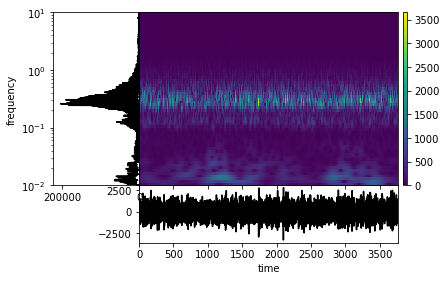

/home/lchuang/anaconda/envs/obspy/lib/python3.7/site-packages/obspy/signal/tf_misfit.py:1501: MatplotlibDeprecationWarning:

shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.



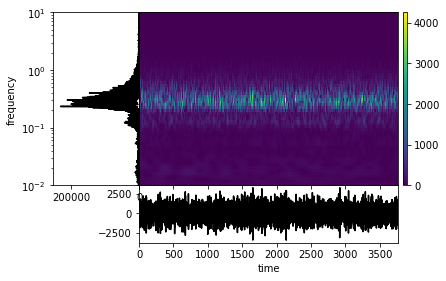

KeyboardInterrupt: 

In [16]:
cluster_index=2
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[12].time)
e_time = UTCDateTime(spec_cluster.iloc[13].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs)  

In [ ]:
cluster_index=2
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[16].time)
e_time = UTCDateTime(spec_cluster.iloc[17].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

### Landslide classified as EQ 

In [ ]:
cluster_index=1
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[18].time)
e_time = UTCDateTime(spec_cluster.iloc[21].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

In [ ]:
cluster_index=1
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[14].time)
e_time = UTCDateTime(spec_cluster.iloc[14].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

In [ ]:
cluster_index=1
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[12].time)
e_time = UTCDateTime(spec_cluster.iloc[12].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 

### Earthquake classified as earthquake (cluster 1)

In [ ]:
cluster_index=1
spec_cluster = pd_cluster[pd_cluster.c_index==cluster_index].reset_index()
spec_cluster.head()
wave_path = wave_path
b_time = UTCDateTime(spec_cluster.iloc[1].time)
e_time = UTCDateTime(spec_cluster.iloc[1].time)
appd_secs=60
plot_spectrogram(wave_path, b_time, e_time, appd_secs) 